In [2]:
!pip install opencv-python
!pip install scikit-image

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.io import imread, imshow
from skimage.color import rgb2hsv, rgb2gray, rgb2yuv, rgba2rgb
from skimage import color, exposure, transform
from skimage.exposure import equalize_hist
import cv2 as cv

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: Non RGB image conversion is now deprecated. For RGBA images, please use rgb2gray(rgba2rgb(rgb)) instead. In version 0.19, a ValueError will be raised if input image last dimension length is not 3.
  


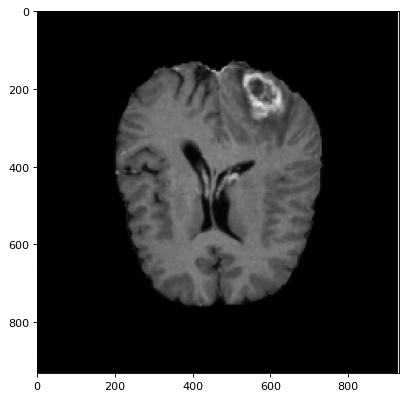

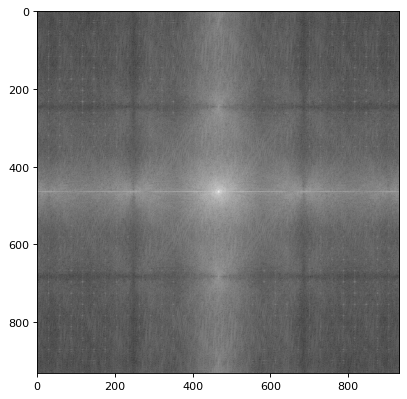

In [4]:
dark_image = imread('brain.png')
dark_image_grey = rgb2gray(dark_image)
dark_image_grey = cv.resize(dark_image_grey, (932, 932))
plt.figure(num=None, figsize=(8, 6), dpi=80)
plt.imshow(dark_image_grey, cmap='gray')
dark_image_grey_fourier = np.fft.fftshift(np.fft.fft2(dark_image_grey))
plt.figure(num=None, figsize=(8, 6), dpi=80)
plt.imshow(np.log(abs(dark_image_grey_fourier)), cmap='gray');

In [5]:
dark_image_grey.shape

(932, 932)

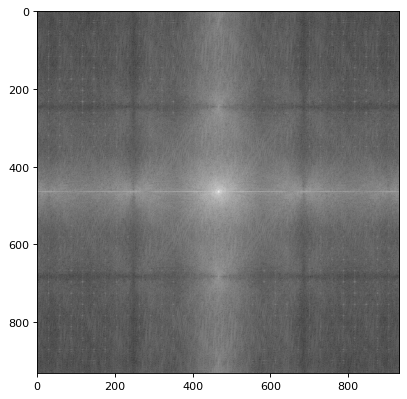

In [6]:
dark_image_grey_fourier = np.fft.fftshift(np.fft.fft2(dark_image_grey))
plt.figure(num=None, figsize=(8, 6), dpi=80)
plt.imshow(np.log(abs(dark_image_grey_fourier)), cmap='gray');

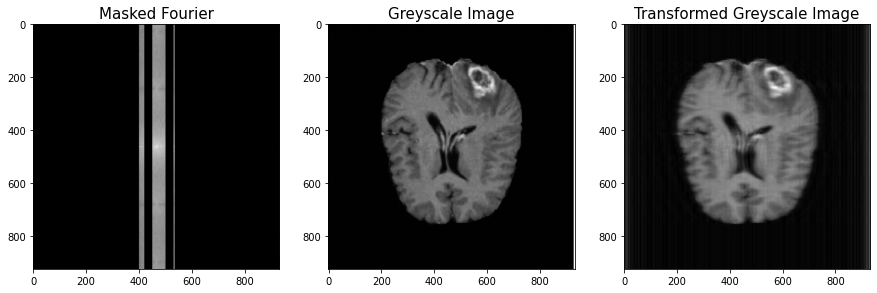

In [36]:
def fourier_masker_ver(image, zero_lines):
    f_size = 15
    dark_image_grey_fourier = np.fft.fftshift(np.fft.fft2(rgb2gray(rgba2rgb(image))))
    w = np.array([1]*image.shape[1])
    for line in zero_lines:
        w[line[0]:line[1]] = 0
    dark_image_grey_fourier = dark_image_grey_fourier * w
    fig, ax = plt.subplots(1,3,figsize=(15,15))
    ax[0].imshow(20*np.log(abs(dark_image_grey_fourier + 0.0001)), cmap='gray') # +0.0001 чтобы np.log ошибку не давал
    ax[0].set_title('Masked Fourier', fontsize = f_size)
    ax[1].imshow(rgb2gray(rgba2rgb(image)), cmap = 'gray')
    ax[1].set_title('Greyscale Image', fontsize = f_size);
    ax[2].imshow(abs(np.fft.ifft2(dark_image_grey_fourier)), 
                     cmap='gray')
    ax[2].set_title('Transformed Greyscale Image', 
                     fontsize = f_size);
        
fourier_masker_ver(dark_image, [[0, 400], [420, 450], [500, 530], [535, -1]])

In [40]:
zero_lines_for_illustration_left = [[0,50], [0,100], [0,150], [0,200], [0,250], [0,300], [0,350],
                                    [0,400], [0,450], [0,500], [0,550], [0,600], [0,650], [0,700]]

zero_lines_for_illustration_right = [[250,-1], [300,-1], [350,-1], [400,-1], [450,-1], [500,-1], [550,-1],
                                     [600,-1], [650,-1], [700,-1], [750,-1], [800,-1], [850,-1], [900,-1]]

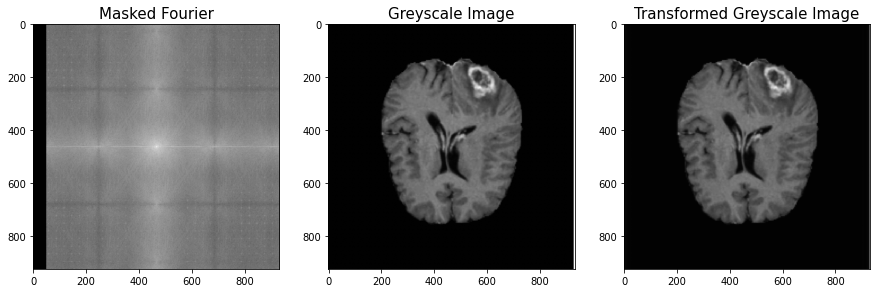

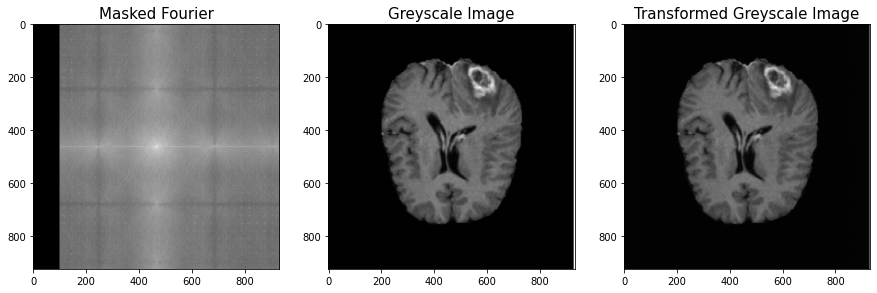

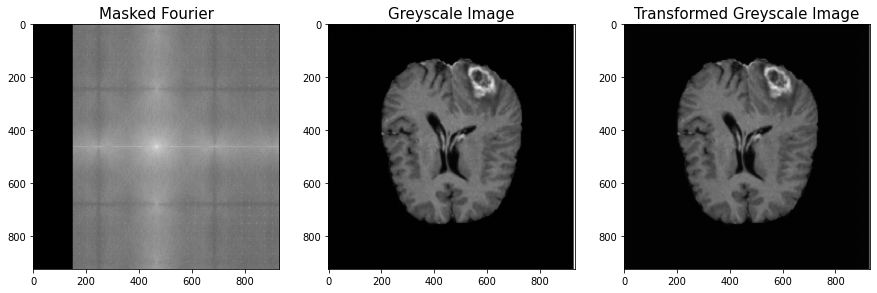

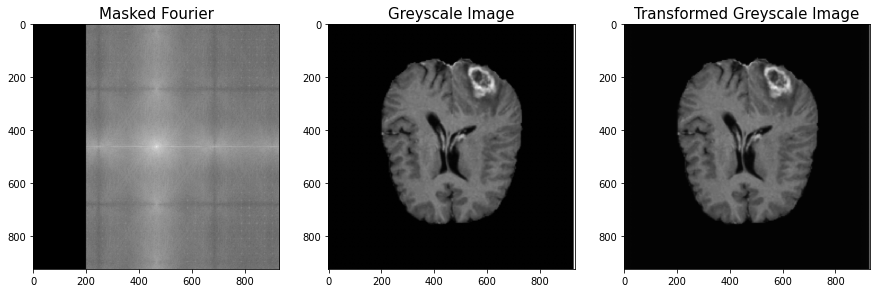

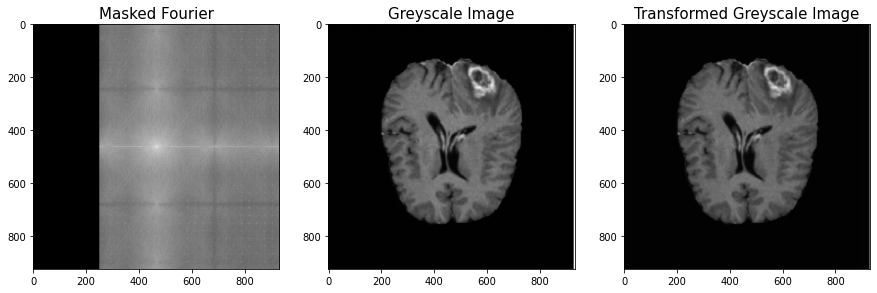

...

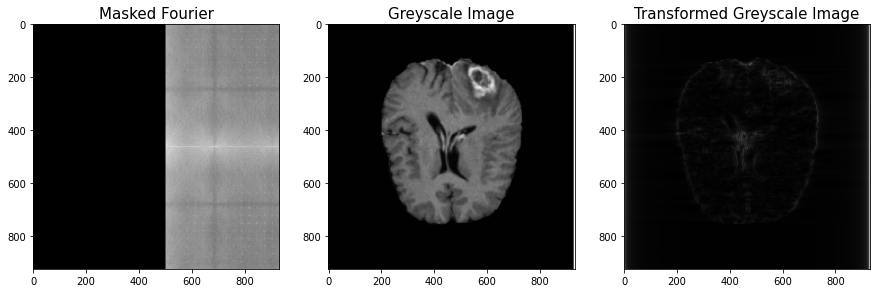

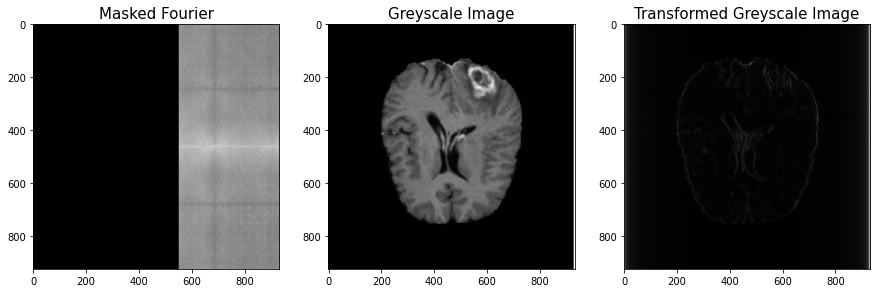

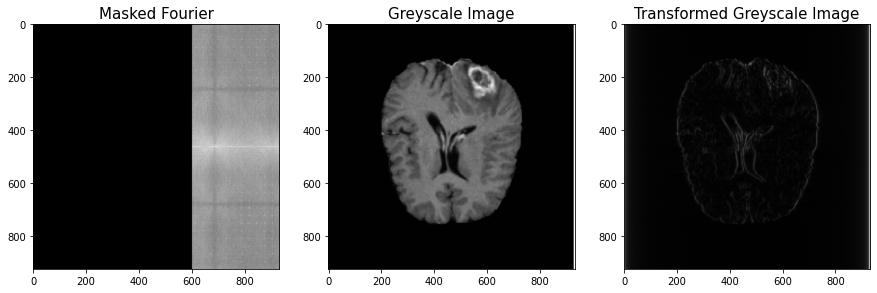

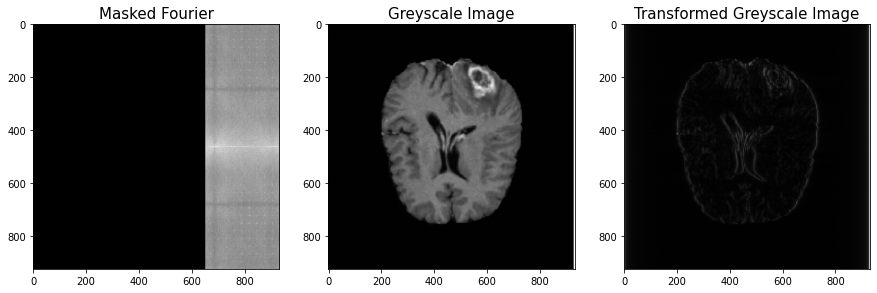

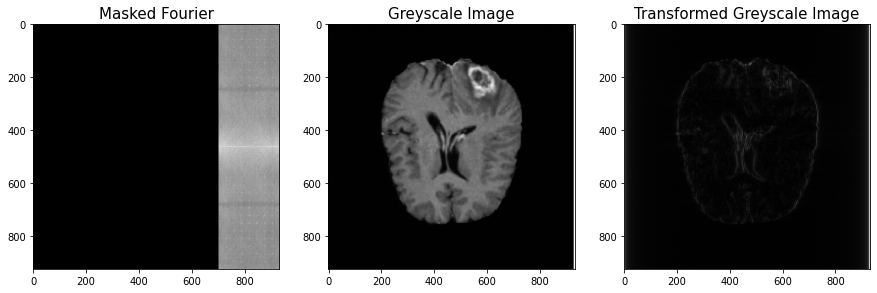

In [41]:
for zero_line in zero_lines_for_illustration_left:
    fourier_masker_ver(dark_image, [zero_line])

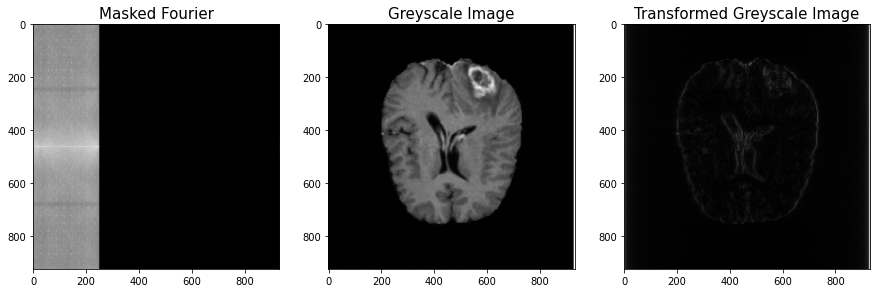

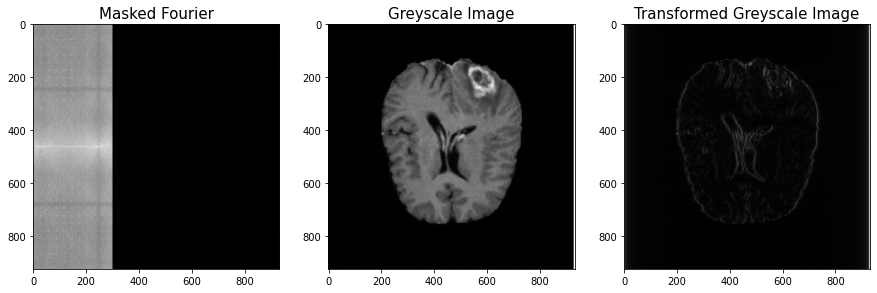

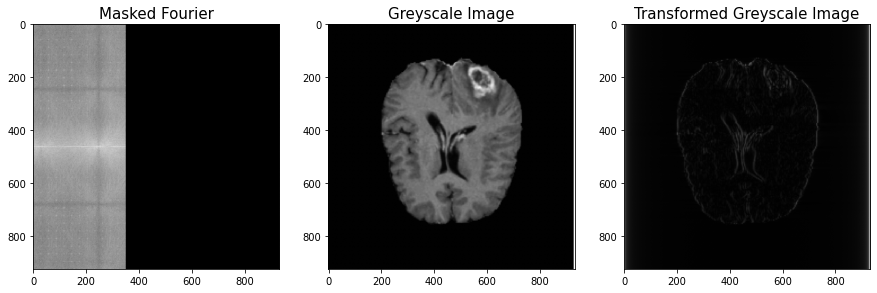

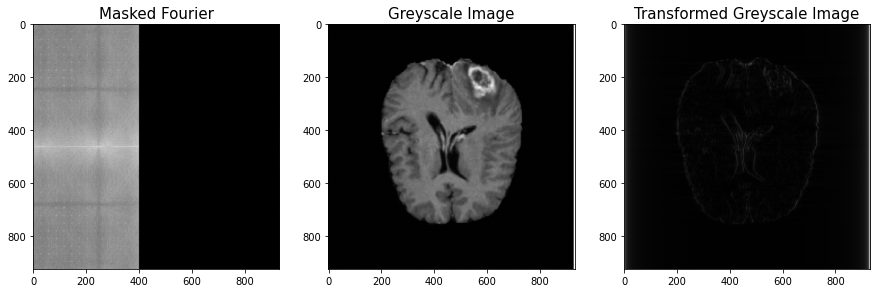

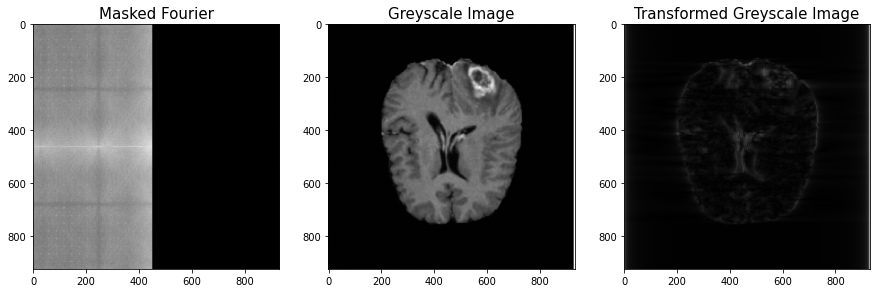

...

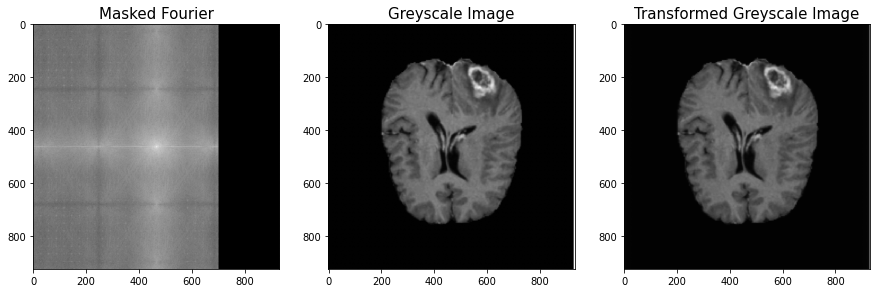

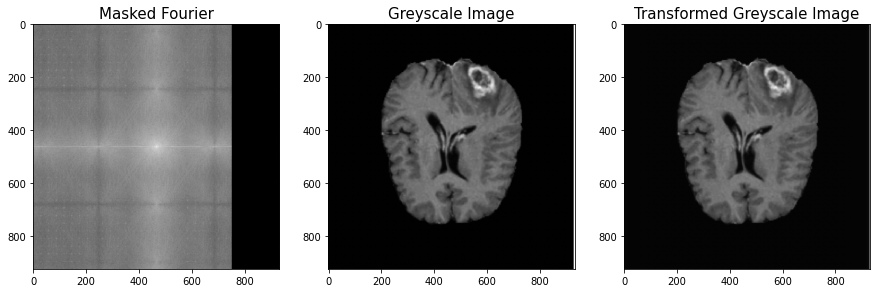

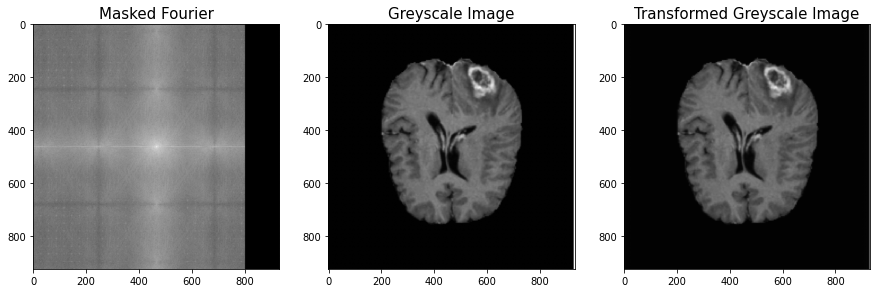

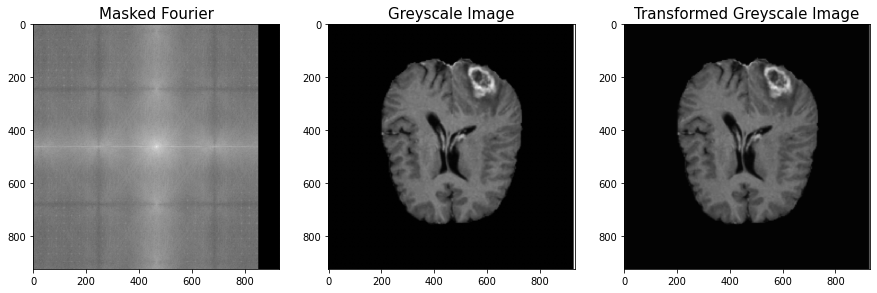

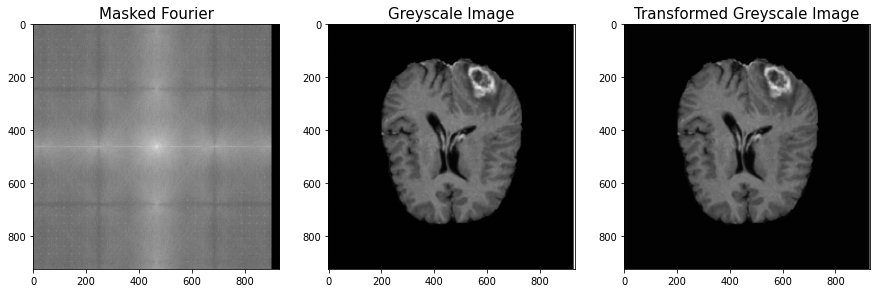

In [42]:
for zero_line in zero_lines_for_illustration_right:
    fourier_masker_ver(dark_image, [zero_line])

# зануляем частоты (не как в статье)

In [43]:
932/2

466.0

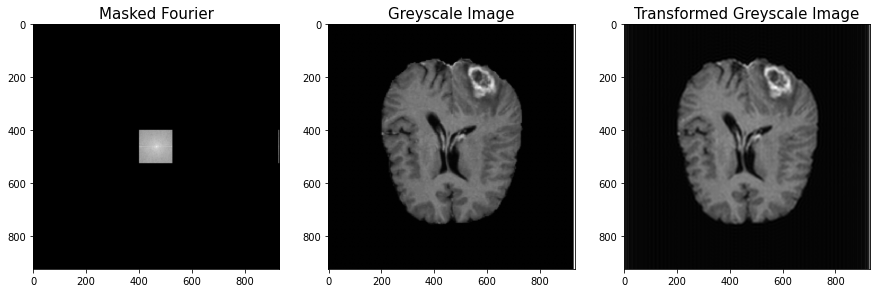

In [51]:
def fourier_masker_lines(image, zero_lines):
    f_size = 15
    im_shape = image.shape[0]
    dark_image_grey_fourier = np.fft.fftshift(np.fft.fft2(rgb2gray(rgba2rgb(image))))
    for line in zero_lines:
        dark_image_grey_fourier[:, line[0]:line[1]] = 0
        dark_image_grey_fourier[line[0]:line[1], :] = 0
        dark_image_grey_fourier[im_shape - line[1]:im_shape - line[0], :] = 0
        dark_image_grey_fourier[:, im_shape - line[1]:im_shape - line[0]] = 0
    fig, ax = plt.subplots(1,3,figsize=(15,15))
    ax[0].imshow(20*np.log(abs(dark_image_grey_fourier + 0.0001)), cmap='gray') # +0.0001 чтобы np.log ошибку не давал
    ax[0].set_title('Masked Fourier', fontsize = f_size)
    ax[1].imshow(rgb2gray(rgba2rgb(image)), cmap = 'gray')
    ax[1].set_title('Greyscale Image', fontsize = f_size);
    ax[2].imshow(abs(np.fft.ifft2(dark_image_grey_fourier)), 
                     cmap='gray')
    ax[2].set_title('Transformed Greyscale Image', 
                     fontsize = f_size);
        
fourier_masker_lines(dark_image, [[0, 400]])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


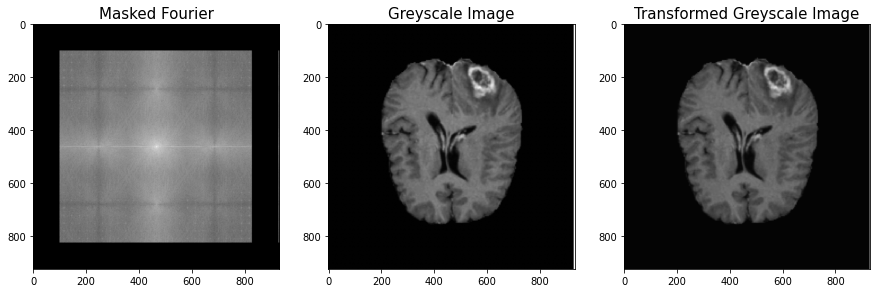

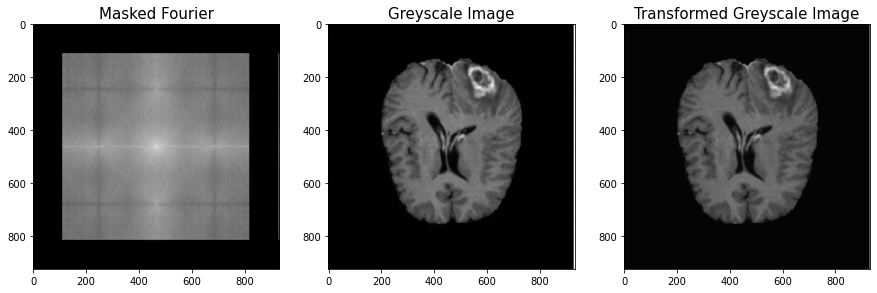

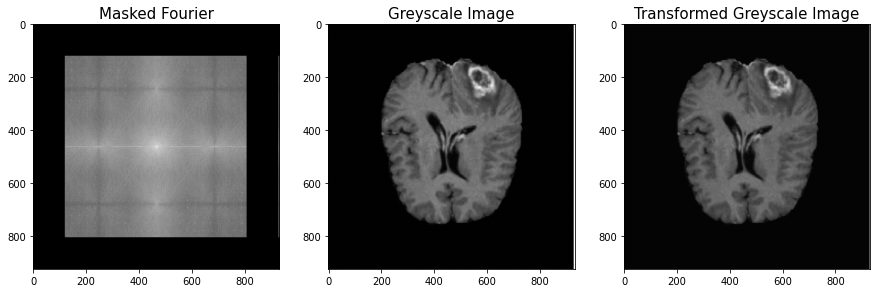

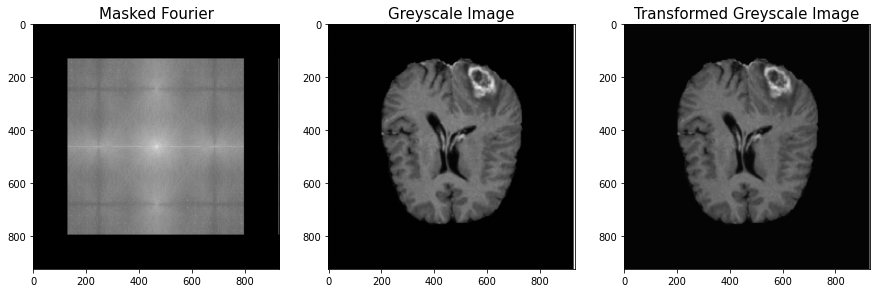

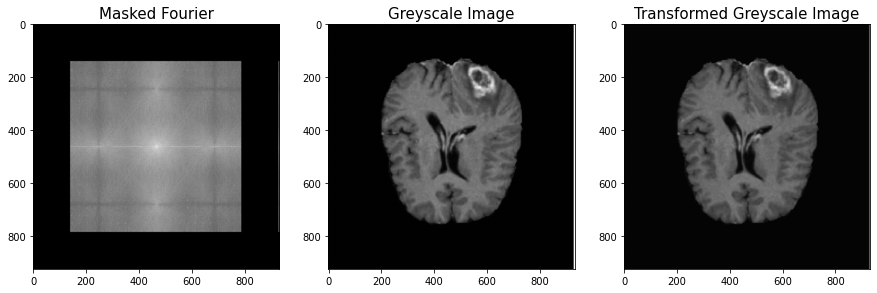

...

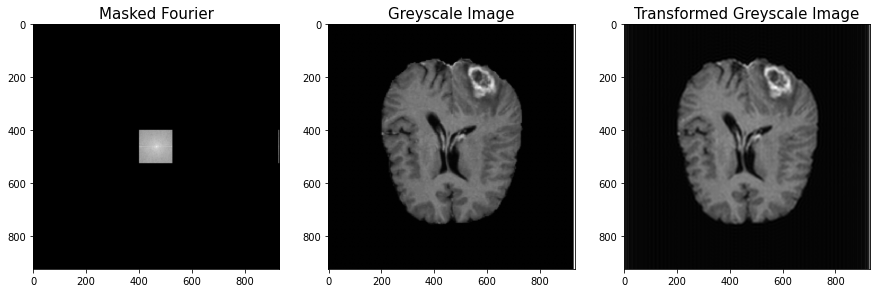

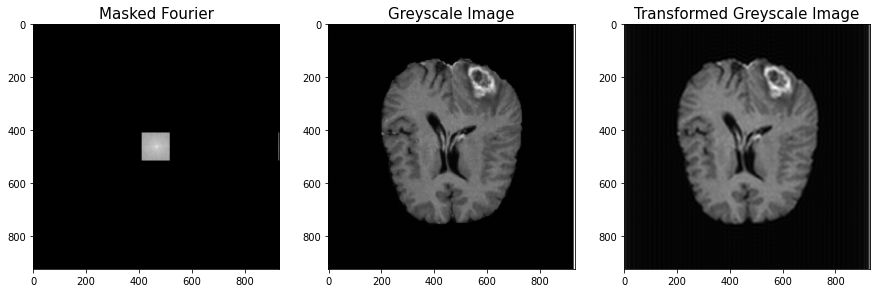

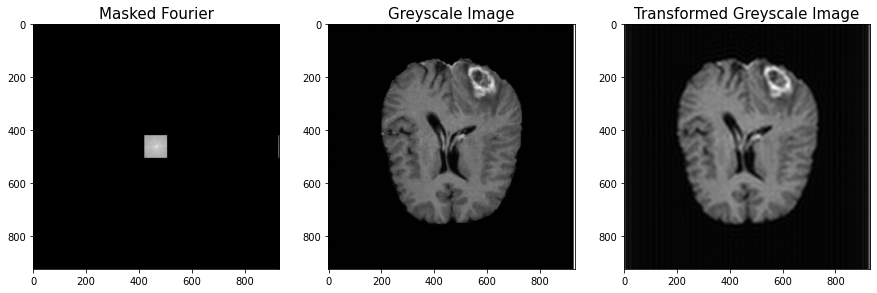

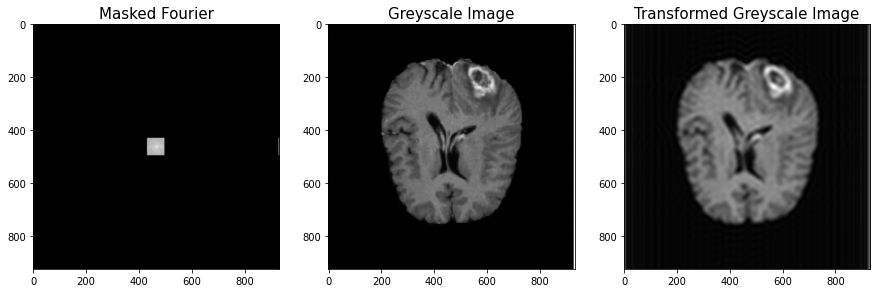

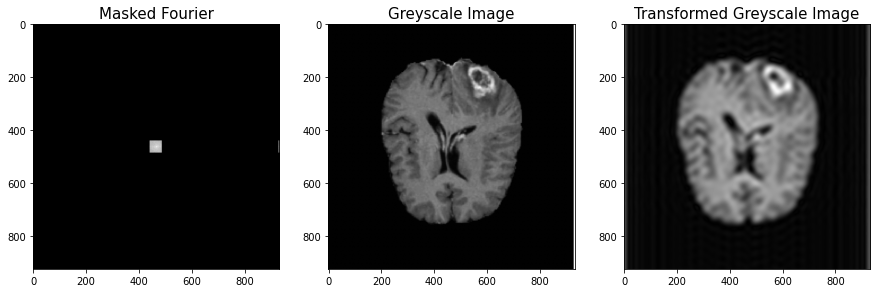

In [54]:
for i in range(100, 450, 10):
    fourier_masker_lines(dark_image, [[0, i]])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


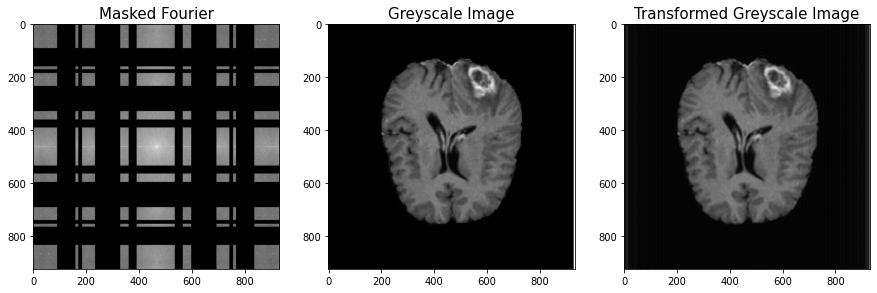

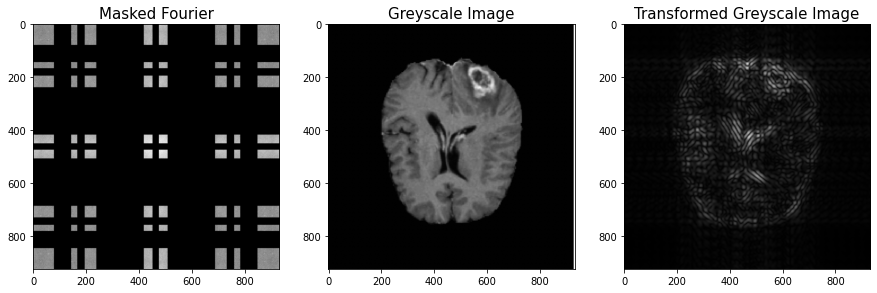

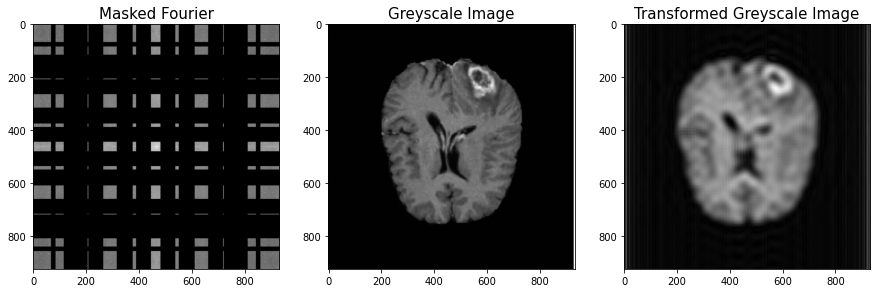

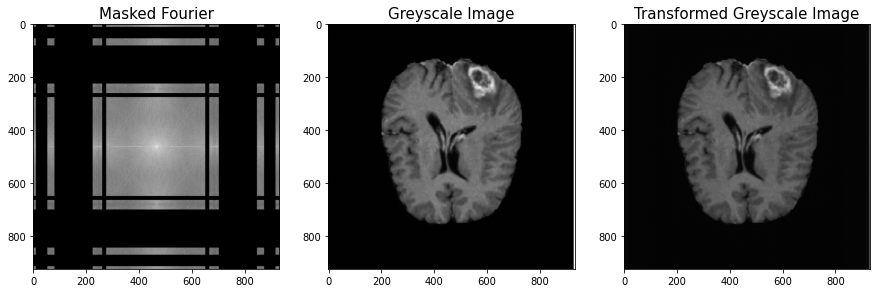

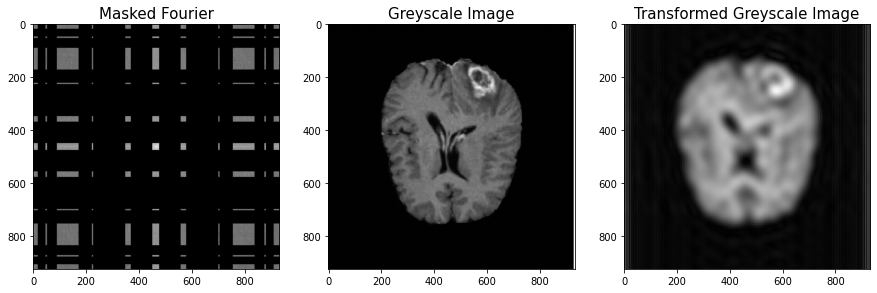

...

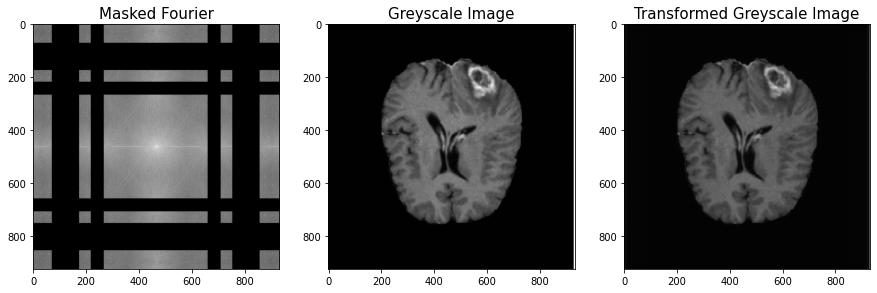

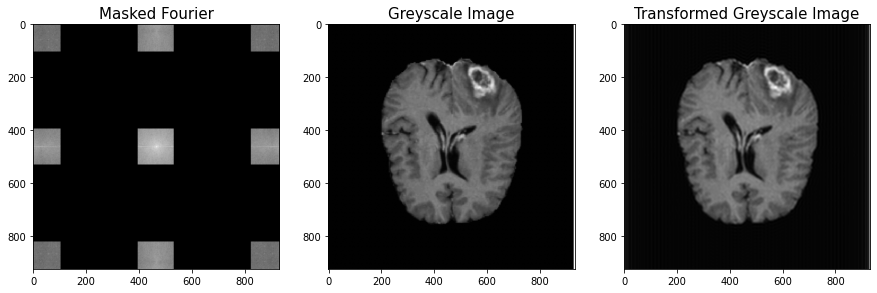

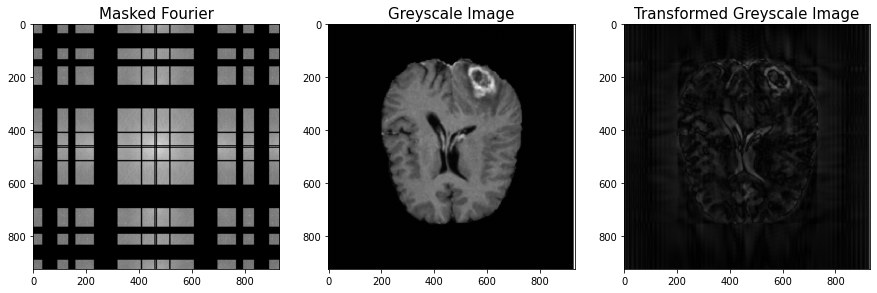

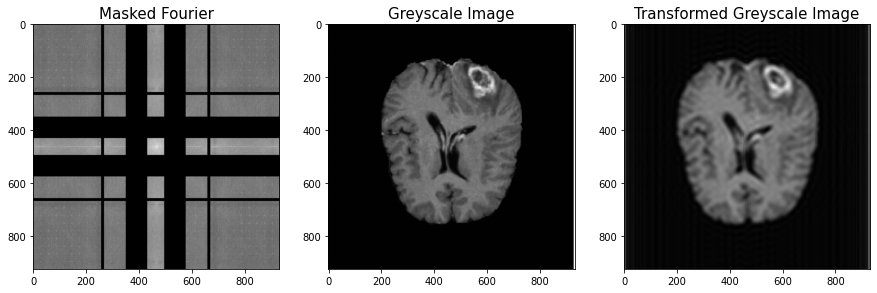

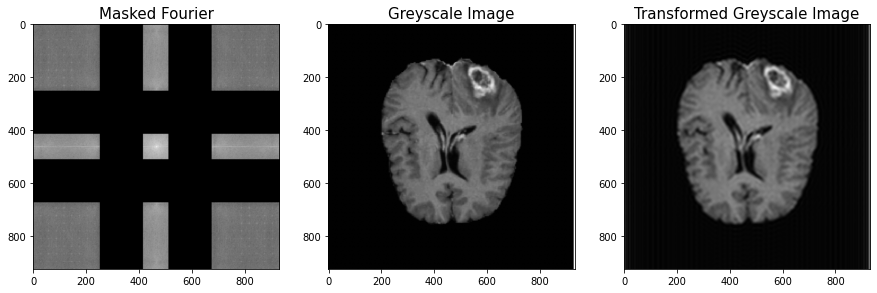

In [67]:
for i in range(50):
    num_of_intervals = np.random.randint(1, 6)
    intervals = np.sort(np.random.random_sample((num_of_intervals * 2,))*466).astype(int).reshape((num_of_intervals,2))
    fourier_masker_lines(dark_image, intervals)

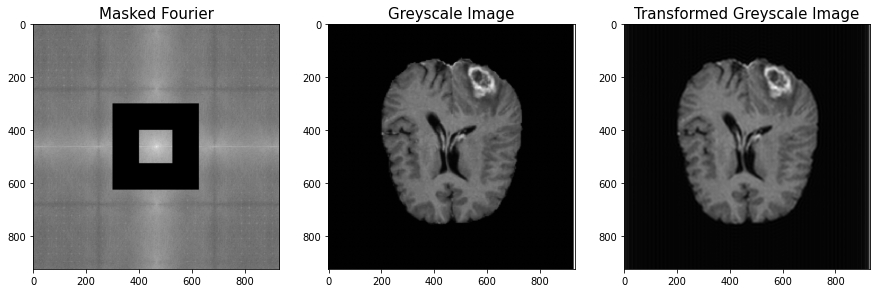

In [74]:
def fourier_masker_rectangular(image, zero_lines):
    f_size = 15
    im_shape = image.shape[0]
    dark_image_grey_fourier = np.fft.fftshift(np.fft.fft2(rgb2gray(rgba2rgb(image))))
    for line in zero_lines:
        dark_image_grey_fourier[line[0]:line[1], line[0]:im_shape - line[0]] = 0
        dark_image_grey_fourier[im_shape - line[1]:im_shape - line[0], line[0]:im_shape - line[0]] = 0
        dark_image_grey_fourier[line[0]:im_shape - line[0], line[0]:line[1]] = 0
        dark_image_grey_fourier[line[0]:im_shape - line[0], im_shape - line[1]:im_shape - line[0]] = 0
    fig, ax = plt.subplots(1,3,figsize=(15,15))
    ax[0].imshow(20*np.log(abs(dark_image_grey_fourier + 0.0001)), cmap='gray') # +0.0001 чтобы np.log ошибку не давал
    ax[0].set_title('Masked Fourier', fontsize = f_size)
    ax[1].imshow(rgb2gray(rgba2rgb(image)), cmap = 'gray')
    ax[1].set_title('Greyscale Image', fontsize = f_size);
    ax[2].imshow(abs(np.fft.ifft2(dark_image_grey_fourier)), 
                     cmap='gray')
    ax[2].set_title('Transformed Greyscale Image', 
                     fontsize = f_size);
        
fourier_masker_rectangular(dark_image, [[300, 400]])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


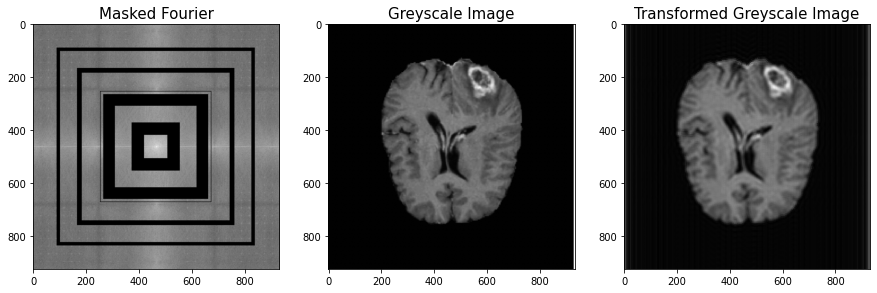

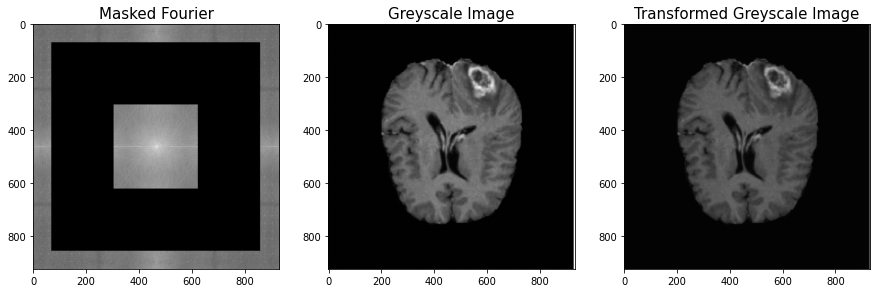

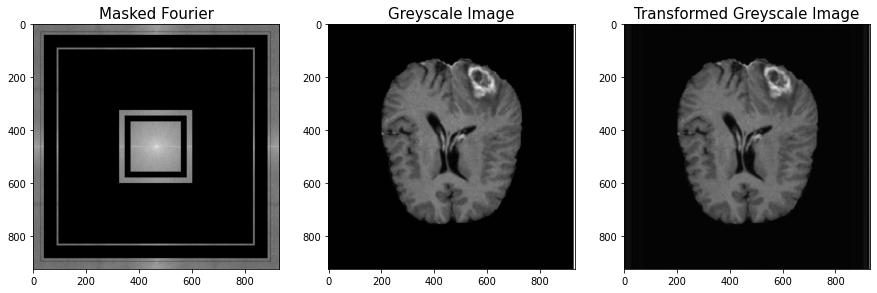

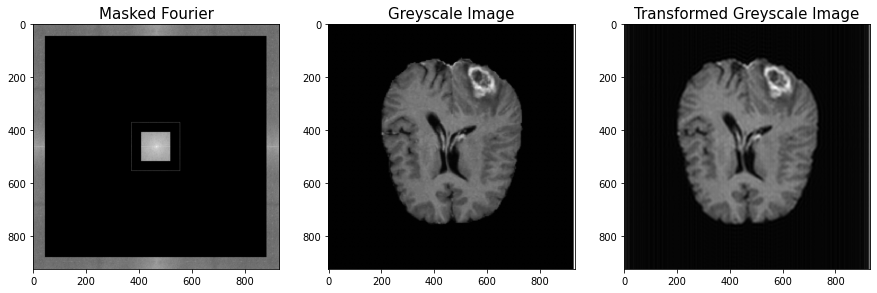

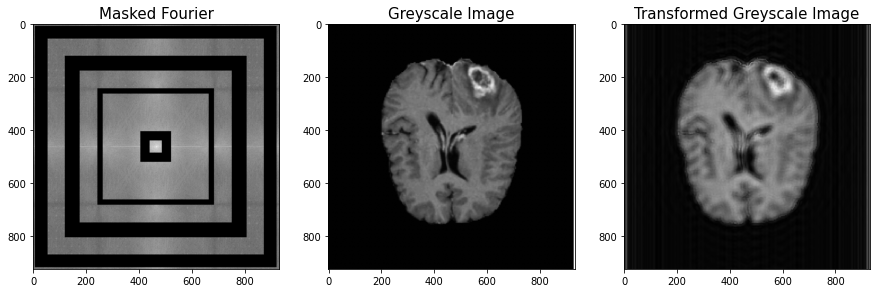

...

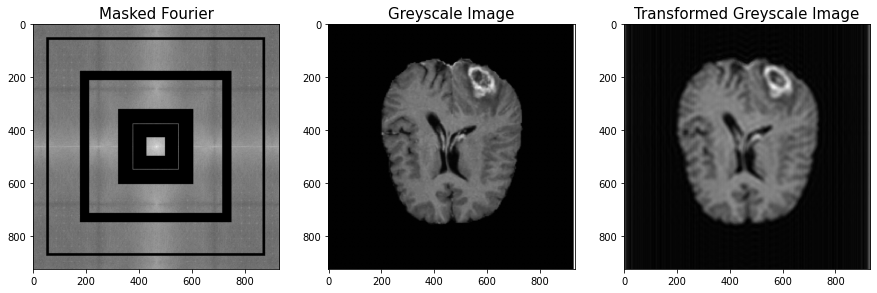

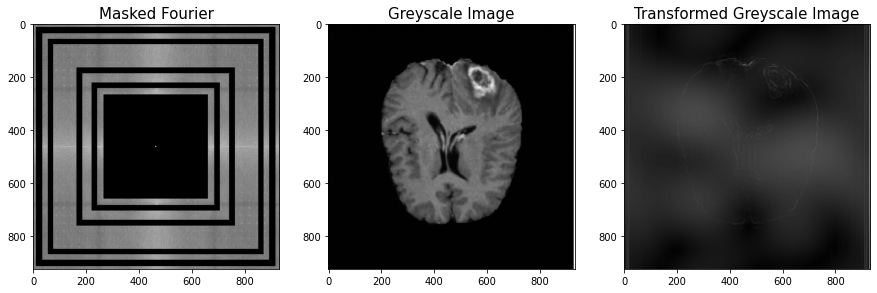

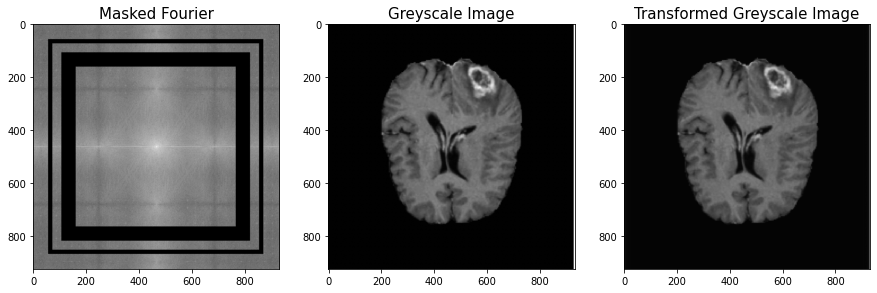

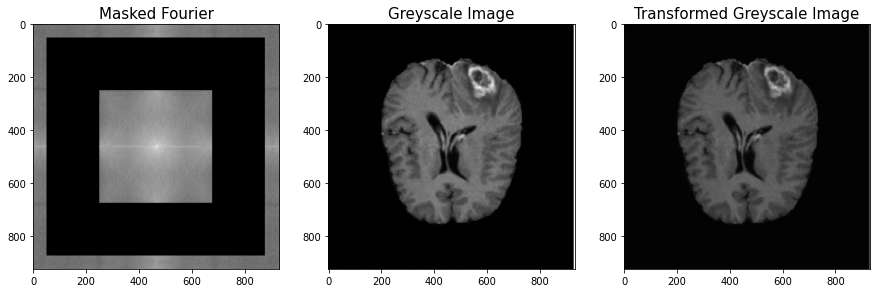

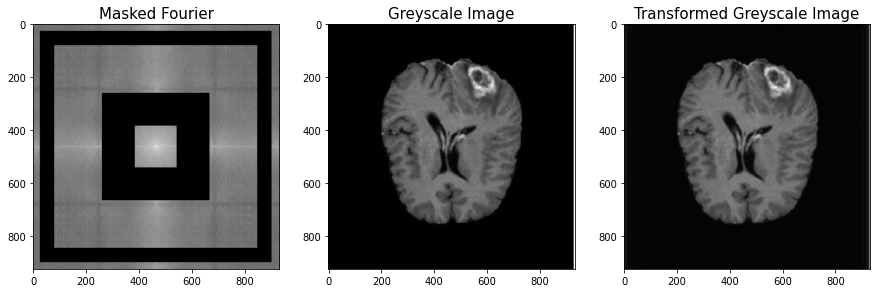

In [75]:
for i in range(50):
    num_of_intervals = np.random.randint(1, 6)
    intervals = np.sort(np.random.random_sample((num_of_intervals * 2,))*466).astype(int).reshape((num_of_intervals,2))
    fourier_masker_rectangular(dark_image, intervals)